In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
import plotly.io as pio
pio.renderers.default = "plotly_mimetype+notebook"


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff


## Importing data

In [4]:
single_family_data_raw = pd.read_excel('data/Customer Watch Query billed FY19_SFR_Usage RATE OPTIONS.xlsx')
single_family_data_raw.head()

,Unnamed: 0,FY19,BILLING REPORT FOR SINGLE-FAMILY RESIDENTIAL,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18
0,NaN,NaN,NaN,NaN,NaN,NaN,FY23 Tier 1 Rate,FY23 Tier 2 Rate,FY23 Tier 3 Rate,FY23 Monthly,FY23 TOTAL ANNUAL CURRENT BILL,Uniform Rate Option,FY23 TOTAL ANNUAL UNIFORM BILL,NaN,NaN,100% Volume Option,NaN,NaN,NaN
1,Premise Token Number,# Days Billed Fiscal Year,Annual Billed Use (CCF) in Tier 1,Annual Billed Use (CCF) in Tier 2,Annual Billed Use (CCF) in Tier 3,TOTAL ANNUAL USE CCF,4.6,6.32,8.35,30.14,MONTHLY EQUIV,5.569654,MONTHLY EQUIV,Monthly Savings/ Unsavings,Savings/ Unsavings %,9.255462,MONTHLY EQUIV,Monthly Savings/ Unsavings,Savings/ Unsavings %
2,3856900,364,88,106,7136,7330,NaN,NaN,NaN,NaN,5085.166667,NaN,3432.270209,1652.896457,0.325043,NaN,5653.544855,-568.378188,-0.111772
3,5788640,366,88,108,3284,3480,NaN,NaN,NaN,NaN,2405.87,NaN,1645.339608,760.530392,0.316114,NaN,2684.084051,-278.214051,-0.11564
4,4577760,347,84,88,2711,2883,NaN,NaN,NaN,NaN,1995.090833,NaN,1368.249331,626.841503,0.314192,NaN,2223.624804,-228.533971,-0.114548


## Data cleaning

Some data wrangling is necessary to turn the Excel data into a useable format for Python.

In [5]:
single_family_data = single_family_data_raw.copy()

# Hold on to constants defined at top of file
FY23_tier_1_rate = 4.6
FY23_tier_2_rate = 6.32
FY23_tier_3_rate = 8.35
FY23_monthly = 30.14
uniform_rate = 5.569654 
volume_rate = 9.255462 

# Set all rate columns to actual values
single_family_data.iloc[2:,6] = FY23_tier_1_rate
single_family_data.iloc[2:,7] = FY23_tier_2_rate
single_family_data.iloc[2:,8] = FY23_tier_3_rate
single_family_data.iloc[2:,9] = FY23_monthly
single_family_data.iloc[2:,11] = uniform_rate
single_family_data.iloc[2:,15] = volume_rate

# Moving rate column names down a row with the other column names
single_family_data.iloc[1, [6,7,8,9]] = single_family_data.iloc[0, [6,7,8,9]]
single_family_data.iloc[1, [11]] = single_family_data.iloc[0, [11]]
single_family_data.iloc[1, [15]] = single_family_data.iloc[0, [15]]

# Set the DataFrame column names to be the column name row
single_family_data.columns = single_family_data.iloc[1]

# Drop the column name row that
single_family_data = single_family_data.drop([0, 1], axis=0)

# Reset the index
single_family_data = single_family_data.reset_index(drop=True)

# Remove excess rows at the bottom with some summary data
single_family_data = single_family_data.drop(np.arange(330950, 330955), axis=0)

# Fix savings/ unsavings % column to be a percentage rather than a proportion 
single_family_data['Savings/ Unsavings %'] = single_family_data['Savings/ Unsavings %']*100

# Set most columns to be of type float
single_family_data = single_family_data.astype('float')
single_family_data['Premise Token Number'] = single_family_data['Premise Token Number'].astype('int')

single_family_data.head()

1,Premise Token Number,# Days Billed Fiscal Year,Annual Billed Use (CCF) in Tier 1,Annual Billed Use (CCF) in Tier 2,Annual Billed Use (CCF) in Tier 3,TOTAL ANNUAL USE CCF,FY23 Tier 1 Rate,FY23 Tier 2 Rate,FY23 Tier 3 Rate,FY23 Monthly,MONTHLY EQUIV,Uniform Rate Option,MONTHLY EQUIV,Monthly Savings/ Unsavings,Savings/ Unsavings %,100% Volume Option,MONTHLY EQUIV,Monthly Savings/ Unsavings,Savings/ Unsavings %
0,3856900,364.0,88.0,106.0,7136.0,7330.0,4.6,6.32,8.35,30.14,5085.166667,5.569654,3432.270209,1652.896457,32.504273,9.255462,5653.544855,-568.378188,-11.177179
1,5788640,366.0,88.0,108.0,3284.0,3480.0,4.6,6.32,8.35,30.14,2405.870000,5.569654,1645.339608,760.530392,31.611450,9.255462,2684.084051,-278.214051,-11.563969
2,4577760,347.0,84.0,88.0,2711.0,2883.0,4.6,6.32,8.35,30.14,1995.090833,5.569654,1368.249331,626.841503,31.419196,9.255462,2223.624804,-228.533971,-11.454815
3,8527140,368.0,88.0,90.0,2601.0,2779.0,4.6,6.32,8.35,30.14,1921.135833,5.569654,1319.978998,601.156836,31.291740,9.255462,2143.410798,-222.274965,-11.569977
4,4107220,364.0,87.0,83.0,2549.0,2719.0,4.6,6.32,8.35,30.14,1880.882500,5.569654,1292.130728,588.751772,31.301890,9.255462,2097.133487,-216.250987,-11.497315


In [6]:
# Sanity checks
num_accounts_billed_for_tier_1_use = np.count_nonzero(single_family_data['Annual Billed Use (CCF) in Tier 1'])
num_accounts_billed_for_tier_2_use = np.count_nonzero(single_family_data['Annual Billed Use (CCF) in Tier 2'])
num_accounts_billed_for_tier_3_use = np.count_nonzero(single_family_data['Annual Billed Use (CCF) in Tier 3'])
tier_1_ccf_tot = np.sum(single_family_data['Annual Billed Use (CCF) in Tier 1'])
tier_2_ccf_tot = np.sum(single_family_data['Annual Billed Use (CCF) in Tier 2'])
tier_3_ccf_tot = np.sum(single_family_data['Annual Billed Use (CCF) in Tier 3'])

print('# of Accounts billed for')
print(f'Tier 1 Use in Fiscal Year: {num_accounts_billed_for_tier_1_use}')
print(f'Tier 2 Use in Fiscal Year: {num_accounts_billed_for_tier_2_use}')
print(f'Tier 3 Use in Fiscal Year: {num_accounts_billed_for_tier_3_use}\n')

print('Total Use (CCF) in')
print(f'Tier 1: {tier_1_ccf_tot}')
print(f'Tier 2: {tier_2_ccf_tot}')
print(f'Tier 3: {tier_3_ccf_tot}')
print(f'Combined: {tier_1_ccf_tot + tier_2_ccf_tot + tier_3_ccf_tot}')


# of Accounts billed for
Tier 1 Use in Fiscal Year: 329507
Tier 2 Use in Fiscal Year: 182878
Tier 3 Use in Fiscal Year: 71520

Total Use (CCF) in
Tier 1: 20377678.0
Tier 2: 6835705.0
Tier 3: 5261988.0
Combined: 32475371.0


## Exploration

### How much water is used in each tier?

Looking at these water usage distributions, we can observe that most people use between 80 and 90 CCF in tier 1 and very little in tiers 2 and 3. This aligns with expectations of normal water use being 7 CCF per month for tier 1, which 84 CCF annually. 

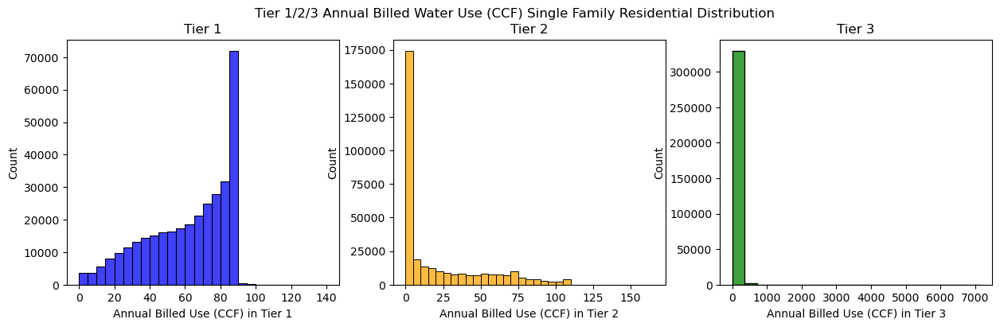

In [7]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15,4))
sns.histplot(data=single_family_data, x='Annual Billed Use (CCF) in Tier 1', ax=ax1, binwidth=5, color='blue');
sns.histplot(data=single_family_data, x='Annual Billed Use (CCF) in Tier 2', ax=ax2, binwidth=5, color='orange');
sns.histplot(data=single_family_data, x='Annual Billed Use (CCF) in Tier 3', ax=ax3, color='green');
ax1.set_title('Tier 1')
ax2.set_title('Tier 2')
ax3.set_title('Tier 3')
plt.suptitle('Tier 1/2/3 Annual Billed Water Use (CCF) Single Family Residential Distribution')
plt.show()

### How much are single family residents paying for water under the current rate structure?

The plot below has a long right tail. There are a couple of outliers samples that are paying significantly more per month compared to most other single family residential customers, causing the visualization to be very stretch out.

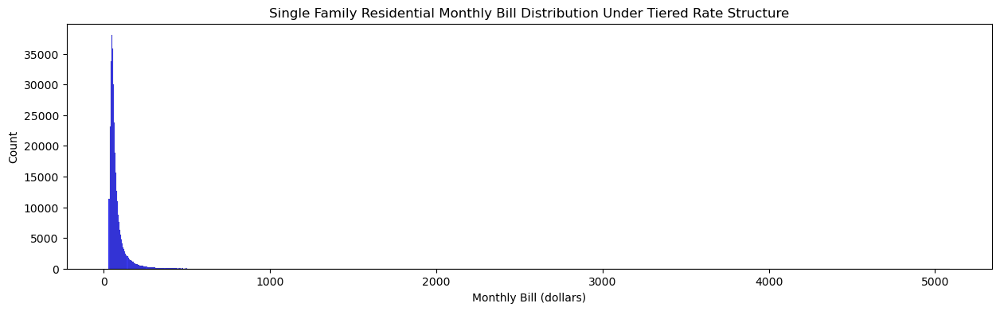

In [8]:
fig, ax = plt.subplots(1, 1, figsize=(15,4))
sns.histplot(x=single_family_data['MONTHLY EQUIV'].iloc[:,0], ax=ax, binwidth=5, color='blue');
ax.set_xlabel('Monthly Bill (dollars)')
ax.set_title('Single Family Residential Monthly Bill Distribution Under Tiered Rate Structure');

### Identifying outliers

I used a 1.5*IQR cutoff to capture outlier samples based on the monthly bill using the current tiered rate structure.

In [9]:
def IQR_flag_outliers(arr):
    # return a boolean array with True for outliers and False for inliers
    q1 = np.percentile(arr, 25)
    q3 = np.percentile(arr, 75) 
    iqr = q3-q1
    return (arr < q1 - 1.5*iqr) | (arr > q3 + 1.5*iqr)

According to this, there were **28177** samples that were identified as being outliers. Of these outlier samples, the max monthly bill was **$5085.17**. This is very high, so it is good that it was captured as an outlier. The minimum monthly bill classified as an outlier was **$134.76**. Looking at the below histogram, 134.76 could actually probably be considered an inlier. However, for the purposes of exploration, it works fine as a cutoff to show the interesting part of the distribution. Also, $5085.17 is a massive monthly bill. I would be interested in learning more about that sample.  

In [10]:
# Identify outliers
outliers = IQR_flag_outliers(single_family_data['MONTHLY EQUIV'].iloc[:,0])
single_family_data[outliers].describe()[['Premise Token Number', 'Annual Billed Use (CCF) in Tier 1', 'Annual Billed Use (CCF) in Tier 2', 'Annual Billed Use (CCF) in Tier 3', 'MONTHLY EQUIV']]


1,Premise Token Number,Annual Billed Use (CCF) in Tier 1,Annual Billed Use (CCF) in Tier 2,Annual Billed Use (CCF) in Tier 3,MONTHLY EQUIV,MONTHLY EQUIV,MONTHLY EQUIV
count,2.817700e+04,28177.000000,28177.000000,28177.000000,28177.000000,28177.000000,28177.000000
mean,5.260086e+06,83.575363,80.925045,158.225822,214.896548,179.929449,248.915037
std,2.229513e+06,6.389325,16.425303,156.818533,110.919488,74.588991,123.949462
min,2.107000e+03,14.000000,13.000000,12.000000,134.759167,108.579291,130.347760
25%,3.351680e+06,81.000000,70.000000,74.000000,152.815833,138.284112,179.710225
50%,5.256600e+06,87.000000,78.000000,112.000000,180.970000,157.313762,211.333055
75%,7.172566e+06,88.000000,93.000000,187.000000,235.719167,193.980650,272.264848
max,9.969246e+06,129.000000,161.000000,7136.000000,5085.166667,3432.270209,5653.544855


Most single family residential families spend between 40 and 60 dollars monthly on water. After removing the outliers, it is more clear that the distribution is fairly wide. The variations in monthly bill could be caused by the differences in tier 1 and tier 2 water usage shown in Annual Billed Water Use histograms from above.

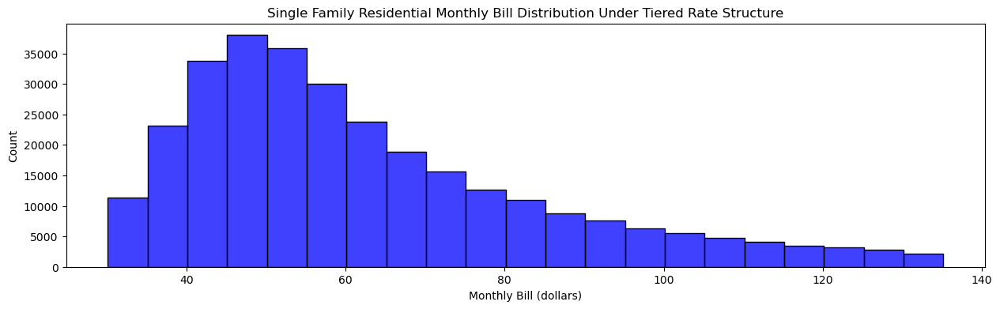

In [11]:
# Remove outliers, then plot again
outliers_removed = single_family_data[~outliers]

fig, ax = plt.subplots(1, 1, figsize=(15,4))
sns.histplot(x=outliers_removed['MONTHLY EQUIV'].iloc[:,0], ax=ax, binwidth=5, color='blue');
ax.set_xlabel('Monthly Bill (dollars)')
ax.set_title('Single Family Residential Monthly Bill Distribution Under Tiered Rate Structure');

## Comparing across rate structures

### Monthly equivalent bill for each rate structure

The rates in each of the rate structures can be changed arbitratily to achieve any revenue goal. In the provided data, the rates for the uniform and volume option were chosen to earn the same revenue as the current tiered structure. Since the amount of revenue gained from each rate structure is the same, we can compare the histograms for monthly bill to see how each rate structure distributes costs across the single residential families. 

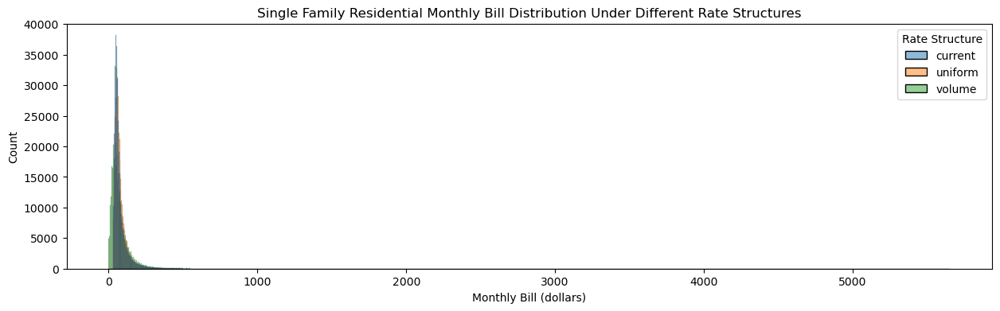

In [12]:
long_df = pd.DataFrame(
    columns=['MONTHLY EQUIV'],
    data=np.vstack((
        single_family_data['MONTHLY EQUIV'].iloc[:,0:1],
        single_family_data['MONTHLY EQUIV'].iloc[:,1:2],
        single_family_data['MONTHLY EQUIV'].iloc[:,2:3],
    ))
)
long_df['Rate Structure'] = np.repeat(['current', 'uniform', 'volume'], single_family_data.shape[0])

fig, ax = plt.subplots(1, 1, figsize=(15,4))
sns.histplot(data=long_df, x='MONTHLY EQUIV', ax=ax, binwidth=5, hue='Rate Structure');
ax.set_xlabel('Monthly Bill (dollars)')
ax.set_title('Single Family Residential Monthly Bill Distribution Under Different Rate Structures');

There is the same issue as before with the outliers. Let's remove those and re-plot.

The volume rate structure distribution is more spread out compared to the other two rate structures which indicates that there is greater variance in what people pay for water under that rate structure. One possible explanation that I can think of for this is that it is more dependent on water use (which has high variance) compared to the other two rate structures which have a monthly service fee.

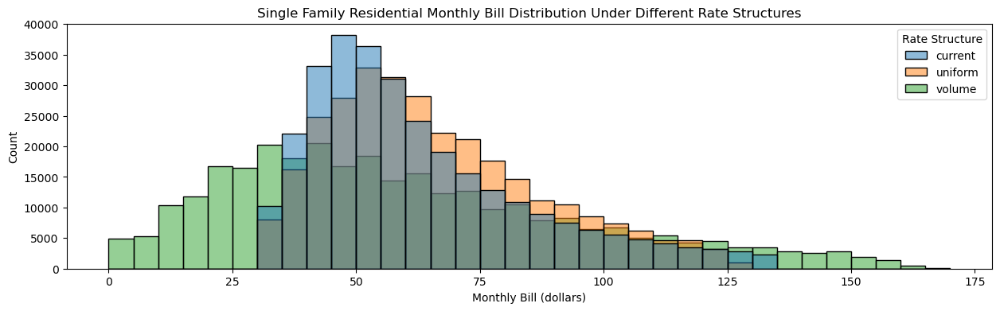

In [13]:
long_df = pd.DataFrame(
    columns=['MONTHLY EQUIV'],
    data=np.vstack((
        outliers_removed['MONTHLY EQUIV'].iloc[:,0:1],
        outliers_removed['MONTHLY EQUIV'].iloc[:,1:2],
        outliers_removed['MONTHLY EQUIV'].iloc[:,2:3],
    ))
)
long_df['Rate Structure'] = np.repeat(['current', 'uniform', 'volume'], outliers_removed.shape[0])

fig, ax = plt.subplots(1, 1, figsize=(15,4))
sns.histplot(data=long_df, x='MONTHLY EQUIV', ax=ax, binwidth=5, hue='Rate Structure');
ax.set_xlabel('Monthly Bill (dollars)')
ax.set_title('Single Family Residential Monthly Bill Distribution Under Different Rate Structures');

In [14]:
# SAME PLOT BUT IN PLOTLY

long_df = pd.DataFrame(
    columns=['MONTHLY EQUIV'],
    data=np.vstack((
        outliers_removed['MONTHLY EQUIV'].iloc[:,0:1],
        outliers_removed['MONTHLY EQUIV'].iloc[:,1:2],
        outliers_removed['MONTHLY EQUIV'].iloc[:,2:3],
    ))
)
long_df['Rate Structure'] = np.repeat(['current', 'uniform', 'volume'], outliers_removed.shape[0])
fig = go.Figure()
fig.add_trace(go.Histogram(x=long_df[long_df['Rate Structure'] == 'current']['MONTHLY EQUIV'], xbins={'size':5}, marker_color='blue', opacity=0.8, name='current'))
fig.add_trace(go.Histogram(x=long_df[long_df['Rate Structure'] == 'uniform']['MONTHLY EQUIV'], xbins={'size':5}, marker_color='orange', opacity=0.8, name='uniform'))
fig.add_trace(go.Histogram(x=long_df[long_df['Rate Structure'] == 'volume']['MONTHLY EQUIV'], xbins={'size':5}, marker_color='green', opacity=0.8, name='volume'))
fig.update_layout(
    title="Single Family Residential Monthly Bill Distribution Under Different Rate Structures",
    xaxis_title="Monthly Bill (dollars)",
    yaxis_title="Count",
    barmode='overlay',
    width=1200,
    height=400)
fig.show()


### Percent savings/unsavings for each rate structure

Another relevant metric included in the data is the percent savings/unsavings for the uniform and volume rate structures compared to the current tiered system. 

In [15]:
def plot_savings_unsavings(savings, log=False):
    fig = go.Figure()
    sorted_savings = np.sort(savings)
    if log:
        sorted_savings = np.log(sorted_savings)
    num_negative = np.sum(sorted_savings < 0)
    idx = np.arange(len(savings)) - num_negative
    split = np.argmax(sorted_savings > 0)

    fig.add_trace(go.Scatter(x=idx[:split], y=sorted_savings[:split], line=dict(color='red'), fill='tozeroy', fillcolor='rgba(250,0,0,0.4)'))
    fig.add_trace(go.Scatter(x=idx[split:], y=sorted_savings[split:], line=dict(color='blue'), fill='tozeroy', fillcolor='rgba(0,0,250,0.4)'))

    fig.update_xaxes(zeroline=True, zerolinewidth=0.5, zerolinecolor='black')
    fig.update_yaxes(zeroline=True, zerolinewidth=0.5, zerolinecolor='black')
    fig.show()
    return fig

In [16]:
pct_savings_unsaving_uniform = single_family_data['Savings/ Unsavings %'].iloc[:,0]
pct_savings_unsaving_volume = single_family_data['Savings/ Unsavings %'].iloc[:,1]

monthly_savings_unsaving_uniform = single_family_data['Monthly Savings/ Unsavings'].iloc[:,0]
monthly_savings_unsaving_volume = single_family_data['Monthly Savings/ Unsavings'].iloc[:,1]

Looking at these two plots, it appears that the volume rate structure results in more people having more savings compared to the uniform rate structure. However, from my observations, there are many people in the data who do not use any water at all. Under the volume rate structure, they no longer pay the monthly service fee, which inflates the savings for the volume rate structure. For the future, I would isolate just the regular water users and see the impact of these rate structures on just that population. 

In [17]:
uniform_sorted_pct_savings = np.sort(pct_savings_unsaving_uniform)
volume_sorted_pct_savings = np.sort(pct_savings_unsaving_volume)

uniform_split = np.argmax(uniform_sorted_pct_savings > 0)
volume_split = np.argmax(volume_sorted_pct_savings > 0)

fig = go.Figure()

fig.add_trace(go.Scatter(x=np.arange(0-uniform_split, 0), y=uniform_sorted_pct_savings[:uniform_split], line=dict(color='red'), fill='tozeroy', fillcolor='rgba(250,0,0,0.4)', name='pct savings'))
fig.add_trace(go.Scatter(x=np.arange(0, uniform_sorted_pct_savings.shape[0]-uniform_split), y=uniform_sorted_pct_savings[uniform_split:], line=dict(color='blue'), fill='tozeroy', fillcolor='rgba(0,0,250,0.4)', name='pct unsavings'))

fig.update_xaxes(zeroline=True, zerolinewidth=0.5, zerolinecolor='black', showticklabels=False)
fig.update_yaxes(zeroline=True, zerolinewidth=0.5, zerolinecolor='black')

fig.update_layout(
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01,
    ),
    width=800,
    height=400,
    yaxis_title='Percent Savings/Unsavings',
    title='Percent Savings/Unsavings for Uniform Rate Structure'
)

fig.show()

In [18]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=np.arange(0-volume_split, 0), y=volume_sorted_pct_savings[:volume_split], line=dict(color='red'), fill='tozeroy', fillcolor='rgba(250,0,0,0.4)', name='pct savings'))
fig.add_trace(go.Scatter(x=np.arange(0, volume_sorted_pct_savings.shape[0]-volume_split), y=volume_sorted_pct_savings[volume_split:], line=dict(color='blue'), fill='tozeroy', fillcolor='rgba(0,0,250,0.4)', name='pct unsavings'))
fig.update_xaxes(zeroline=True, zerolinewidth=0.5, zerolinecolor='black', showticklabels=False)
fig.update_yaxes(zeroline=True, zerolinewidth=0.5, zerolinecolor='black')

fig.update_layout(
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01
    ),
    width=800,
    height=400,
    yaxis_title='Percent Savings/Unsavings',
    title='Percent Savings/Unsavings for Volume Rate Structure'
)

## Sensitivity analysis

An important aspect of a rate structure is how well it performs in adverse water use conditions such as a drought. I make the assumption that under reduced water conditions, people first reduce their tier 3 water usage before their tier 2 water usage and the same with tier 2 and tier 1 water usage. This is almost certainly not accurate to reality because the customers probably do not act so optimally, but I think it is a necessary assumption to make with the limitations of the data.

In [19]:
def reduced_water_use(tier_1, tier_2, tier_3, pct):
    """ 
    Utility function for modeling optimal water use by customers. Water use in tier_3 is eliminated before decreasing tier_2 water use. 
    For example, if a customer uses 10 CCF of water in each of tier 1, 2 and 3, then a decrease in 12 CCF of water usage would result in 10, 8, and 0 CCF of water use
    in each of those tiers respectively. 
    """
    tot_water_use = tier_1 + tier_2 + tier_3
    new_tot_water_use = tot_water_use * pct/100
    tier_1_usage = min(tier_1, new_tot_water_use)
    new_tot_water_use = max(0, new_tot_water_use - tier_1_usage)
    tier_2_usage = min(tier_2, new_tot_water_use)
    new_tot_water_use = max(0, new_tot_water_use - tier_2_usage)
    tier_3_usage = min(tier_3, new_tot_water_use)
    return [tier_1_usage, tier_2_usage, tier_3_usage]

def current_monthly_bill(tier_1, tier_2, tier_3, service_fee):
    return FY23_tier_1_rate * tier_1 + FY23_tier_2_rate * tier_2 + FY23_tier_3_rate*tier_3 + service_fee*12

def uniform_monthly_bill(tier_1, tier_2, tier_3, service_fee):
    return uniform_rate * (tier_1 + tier_2 + tier_3) + service_fee*12

def volume_monthly_bill(tier_1, tier_2, tier_3, service_fee):
    return volume_rate * (tier_1 + tier_2 + tier_3)


In [20]:
water_usage_df = pd.DataFrame(columns=['tier1', 'tier2', 'tier3'],data=single_family_data[['Annual Billed Use (CCF) in Tier 1', 'Annual Billed Use (CCF) in Tier 2', 'Annual Billed Use (CCF) in Tier 3']].to_numpy())

pcts = [100, 90, 80, 70, 60, 50, 40, 30, 20, 10, 0]
revenue_current = []
revenue_uniform = []
revenue_volume = []
for pct in pcts:
    reduced_water_usage_df = pd.DataFrame(columns=['tier1', 'tier2', 'tier3'],data=np.array(water_usage_df.apply(lambda r: reduced_water_use(r.tier1, r.tier2, r.tier3, pct), axis=1).to_list()))
    tier_1 = reduced_water_usage_df['tier1']
    tier_2 = reduced_water_usage_df['tier2']
    tier_3 = reduced_water_usage_df['tier3']
    revenue_current.append(current_monthly_bill(tier_1, tier_2, tier_3, FY23_monthly).sum())
    revenue_uniform.append(uniform_monthly_bill(tier_1, tier_2, tier_3, FY23_monthly).sum())
    revenue_volume.append(volume_monthly_bill(tier_1, tier_2, tier_3, FY23_monthly).sum())


As water usage decreases, the volume rate structure decreases the fastest. It is difficult to see in this plot, but the current (tiered) rate structure has small inflections from the customers zeroing out their tier 3 and tier 2 water usage, allowing the uniform rate structure to catch up in slope. The current rate structure initially decreased faster than the uniform rate structure but later decreased slower. 

In [21]:
reduced_water_use_revenue_df = pd.DataFrame(columns=['Total Annual Revenue'], data=np.hstack((revenue_current, revenue_uniform, revenue_volume)))
reduced_water_use_revenue_df['Rate Structure'] = np.repeat(['current', 'uniform', 'volume'], reduced_water_use_revenue_df.shape[0]/3)
reduced_water_use_revenue_df['Percent Water Usage'] = pcts * 3

fig = px.line(data_frame=reduced_water_use_revenue_df, x='Percent Water Usage', y='Total Annual Revenue', color='Rate Structure')
fig.update_layout(
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01
    ),
    title='Total Annual Revenue on Percent Water Usage for Different Rate Structures'
)
fig.show()